In [14]:
import os


import geopandas as gpd
from  fiona import listlayers

#maps
russiaMaps='https://github.com/ython0123/Semana14/raw/main/maps/russiaMaps_5940.gpkg'

#layers in maps
listlayers(russiaMaps)

['country', 'cities', 'rivers']

In [15]:
#Recuperando cada capa
russia=gpd.read_file(russiaMaps,layer='country')
russia_cities=gpd.read_file(russiaMaps,layer='cities')
russia_rivers=gpd.read_file(russiaMaps,layer='rivers')

In [16]:
#Comparten el mismo CRS
russia.crs.to_epsg()==russia_cities.crs.to_epsg()==russia_rivers.crs.to_epsg()

True

<Axes: >

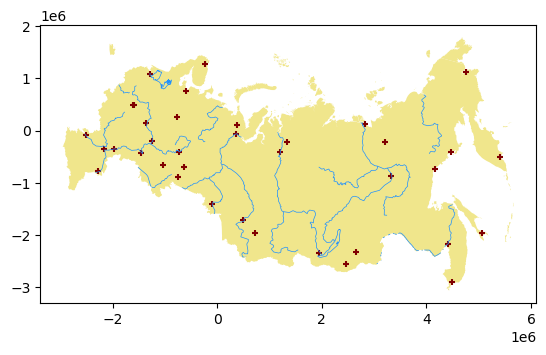

In [17]:
base = russia.plot(facecolor="khaki")
russia_rivers.plot(edgecolor='dodgerblue', linewidth=0.5,ax=base)
russia_cities.plot(marker='+', color='maroon', markersize=15,ax=base)

In [18]:
#Ejercicio 01

**russia_5940** es un multipoligono:

In [19]:
russia

,COUNTRY,geometry
0,Russia,"MULTIPOLYGON (((1324602.705 1368827.791, 13237..."


In [20]:
russia.boundary

0    MULTILINESTRING ((1324602.705 1368827.791, 132...
dtype: geometry

<Axes: >

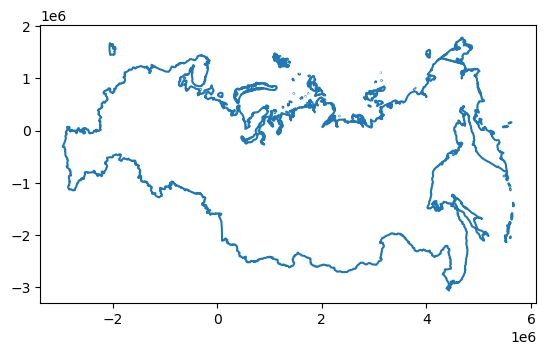

In [21]:
russia.boundary.plot()

In [22]:
type(russia.boundary)

geopandas.geoseries.GeoSeries

In [23]:
# converting into GDF
russia.boundary.to_frame()

,0
0,"MULTILINESTRING ((1324602.705 1368827.791, 132..."


In [24]:
# conversion
russia_border=russia.boundary.to_frame() 

# new column (optional)
russia_border['name']='Russia' 

# renaming the geometry column
russia_border.rename(columns={0:'geometry'},inplace=True) 

#setting the geometry (the name is not enough)
russia_border = russia_border.set_geometry("geometry")

# verifying:
russia_border.crs

<Projected CRS: EPSG:5940>
Name: WGS 84 / EPSG Russia Polar Stereographic
Axis Info [cartesian]:
- X[south]: Easting (metre)
- Y[south]: Northing (metre)
Area of Use:
- name: Northern hemisphere - north of 60°N onshore and offshore, including Arctic.
- bounds: (-180.0, 60.0, 180.0, 90.0)
Coordinate Operation:
- name: EPSG Russia Polar Stereographic
- method: Polar Stereographic (variant A)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [25]:
russia_border

,geometry,name
0,"MULTILINESTRING ((1324602.705 1368827.791, 132...",Russia


In [26]:
#Ejercicio 02

In [27]:
russia_states=gpd.read_file(os.path.join("maps","rus_adm_gadm_2022_v03","rus_admbnda_adm1_gadm_2022_v02.shp"))
russia_municipalities=gpd.read_file(os.path.join("maps","rus_adm_gadm_2022_v03","rus_admbnda_adm2_gadm_2022_v02.shp"))

In [28]:
russia_states.crs, russia_municipalities.crs

(<Geographic 2D CRS: EPSG:4326>
 Name: WGS 84
 Axis Info [ellipsoidal]:
 - Lat[north]: Geodetic latitude (degree)
 - Lon[east]: Geodetic longitude (degree)
 Area of Use:
 - name: World.
 - bounds: (-180.0, -90.0, 180.0, 90.0)
 Datum: World Geodetic System 1984 ensemble
 - Ellipsoid: WGS 84
 - Prime Meridian: Greenwich,
 <Geographic 2D CRS: EPSG:4326>
 Name: WGS 84
 Axis Info [ellipsoidal]:
 - Lat[north]: Geodetic latitude (degree)
 - Lon[east]: Geodetic longitude (degree)
 Area of Use:
 - name: World.
 - bounds: (-180.0, -90.0, 180.0, 90.0)
 Datum: World Geodetic System 1984 ensemble
 - Ellipsoid: WGS 84
 - Prime Meridian: Greenwich)

<Axes: >

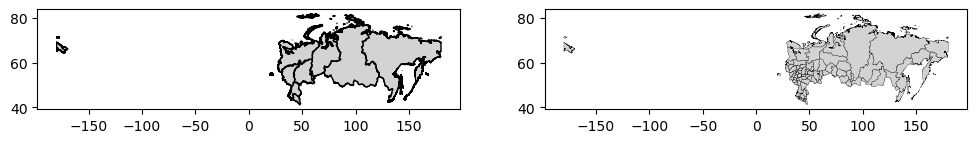

In [29]:
import matplotlib.pyplot as plt

fig, (ax1, ax2) = plt.subplots(ncols=2, sharex=False, sharey=False, figsize=(12,12))

russia_states.plot(ax=ax1, facecolor='lightgrey', edgecolor='black')
russia_municipalities.plot(ax=ax2, facecolor='lightgrey', edgecolor='black',linewidth=0.2)

In [30]:
russia_states.to_crs(5940)

,iso3,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,UNHCR_code,geometry
0,RUS,Russian Federation,RU,Volga Federal District,RU008,20RUS008,"POLYGON Z ((-296275.790 -256315.483 0.000, -30..."
1,RUS,Russian Federation,RU,Far Eastern Federal District,RU002,20RUS002,"MULTIPOLYGON Z (((2274598.412 99307.029 0.000,..."
2,RUS,Russian Federation,RU,Siberian Federal District,RU005,20RUS005,MULTIPOLYGON Z (((2158789.760 275339.243 0.000...
3,RUS,Russian Federation,RU,Ural Federal District,RU007,20RUS007,"MULTIPOLYGON Z (((515936.589 182250.679 0.000,..."
4,RUS,Russian Federation,RU,North Caucasus federal district,RU003,20RUS003,"POLYGON Z ((-2511397.091 -448846.511 0.000, -2..."
5,RUS,Russian Federation,RU,South federal district,RU006,20RUS006,MULTIPOLYGON Z (((-2582643.832 32599.747 0.000...
6,RUS,Russian Federation,RU,Central Federal District,RU001,20RUS001,"POLYGON Z ((-923840.593 164228.050 0.000, -950..."
7,RUS,Russian Federation,RU,Northwestern Federal District,RU004,20RUS004,MULTIPOLYGON Z (((-1438094.868 1222663.010 0.0...


In [31]:
russia_states.geometry.head()

0    POLYGON Z ((59.49710 61.57760 0.00000, 59.4607...
1    MULTIPOLYGON Z (((113.22080 72.82710 0.00000, ...
2    MULTIPOLYGON Z (((110.26040 74.49170 0.00000, ...
3    MULTIPOLYGON Z (((65.77080 69.08960 0.00000, 6...
4    POLYGON Z ((43.49370 45.97900 0.00000, 43.5803...
Name: geometry, dtype: geometry

In [32]:
russia_states.crs = "EPSG:4326"
russia_municipalities.crs = "EPSG:4326"

In [33]:
russia_states=russia_states.to_crs(5940)
russia_municipalities=russia_municipalities.to_crs(5940)

In [34]:
russia_states.crs, russia_municipalities.crs

(<Projected CRS: EPSG:5940>
 Name: WGS 84 / EPSG Russia Polar Stereographic
 Axis Info [cartesian]:
 - X[south]: Easting (metre)
 - Y[south]: Northing (metre)
 Area of Use:
 - name: Northern hemisphere - north of 60°N onshore and offshore, including Arctic.
 - bounds: (-180.0, 60.0, 180.0, 90.0)
 Coordinate Operation:
 - name: EPSG Russia Polar Stereographic
 - method: Polar Stereographic (variant A)
 Datum: World Geodetic System 1984 ensemble
 - Ellipsoid: WGS 84
 - Prime Meridian: Greenwich,
 <Projected CRS: EPSG:5940>
 Name: WGS 84 / EPSG Russia Polar Stereographic
 Axis Info [cartesian]:
 - X[south]: Easting (metre)
 - Y[south]: Northing (metre)
 Area of Use:
 - name: Northern hemisphere - north of 60°N onshore and offshore, including Arctic.
 - bounds: (-180.0, 60.0, 180.0, 90.0)
 Coordinate Operation:
 - name: EPSG Russia Polar Stereographic
 - method: Polar Stereographic (variant A)
 Datum: World Geodetic System 1984 ensemble
 - Ellipsoid: WGS 84
 - Prime Meridian: Greenwich)

In [35]:
#Ejercicio 03

In [36]:
import pandas as pd 
infoairports=pd.read_csv(os.path.join("data","ru-airports.csv"))

# see

infoairports

,id,ident,type,name,latitude_deg,longitude_deg,elevation_ft,continent,country_name,iso_country,...,municipality,scheduled_service,gps_code,iata_code,local_code,home_link,wikipedia_link,keywords,score,last_updated
0,#meta +id,#meta +code,#loc +airport +type,#loc +airport +name,#geo +lat,#geo +lon,#geo +elevation +ft,#region +continent +code,#country +name,#country +code +iso2,...,#loc +municipality +name,#status +scheduled,#loc +airport +code +gps,#loc +airport +code +iata,#loc +airport +code +local,#meta +url +airport,#meta +url +wikipedia,#meta +keywords,#meta +score,#date +updated
1,26396,UUEE,large_airport,Sheremetyevo International Airport,55.972599,37.4146,622,EU,Russia,RU,...,Moscow,1,UUEE,SVO,NaN,http://www.svo.aero/en/,https://en.wikipedia.org/wiki/Sheremetyevo_Int...,"MOW, Международный аэропорт Шереметьево, svo, ...",1012675,2016-10-24T15:52:44+00:00
2,26394,UUDD,large_airport,Domodedovo International Airport,55.40879821777344,37.90629959106445,588,EU,Russia,RU,...,Moscow,1,UUDD,DME,NaN,http://www.domodedovo.ru/en/,https://en.wikipedia.org/wiki/Domodedovo_Inter...,"MOW, Аэропорт Домоде́дово",51200,2008-06-13T14:30:04+00:00
3,6489,ULLI,large_airport,Pulkovo Airport,59.80030059814453,30.262500762939453,78,EU,Russia,RU,...,St. Petersburg,1,ULLI,LED,NaN,http://www.pulkovoairport.ru/,https://en.wikipedia.org/wiki/Pulkovo_Airport,"Аэропо́рт Пу́лково, Leningrad, Shosseynaya Air...",1200,2008-06-13T14:30:04+00:00
4,26401,UUWW,large_airport,Vnukovo International Airport,55.5914993286,37.2615013123,685,EU,Russia,RU,...,Moscow,1,UUWW,VKO,NaN,http://www.vnukovo.ru/eng,https://en.wikipedia.org/wiki/Vnukovo_Internat...,"MOW, Международный аэропорт Внуково",1000,2013-10-06T05:53:16+00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,353428,RU-0894,heliport,Zheltura Heliport,50.46267,105.09323,2356,EU,Russia,RU,...,Zheltura,0,NaN,NaN,NaN,NaN,NaN,NaN,0,2022-03-09T02:14:04+00:00
1554,352501,RU-0809,heliport,Zhuravlevka Heliport,49.09049,129.99353,305,EU,Russia,RU,...,Zhuravlevka,0,NaN,NaN,NaN,NaN,NaN,NaN,0,2022-02-08T17:59:26+00:00
1555,341696,RU-0667,heliport,Zimenki Heliport,56.156272,44.251689,NaN,EU,Russia,RU,...,Zimenki,0,NaN,NaN,NaN,NaN,NaN,NaN,0,2021-03-05T14:09:59+00:00
1556,352996,RU-0859,heliport,Zorgol Heliport,50.5872,119.25723,1650,EU,Russia,RU,...,Zorgol,0,NaN,NaN,NaN,NaN,NaN,NaN,0,2022-02-24T18:56:07+00:00


In [37]:
# bye first row 
infoairports.drop(index=0,inplace=True)
infoairports.reset_index(drop=True, inplace=True)

# keep the  columns needed
keep=['name','type','latitude_deg', 'longitude_deg','elevation_ft','region_name','municipality']
infoairports=infoairports.loc[:,keep]
infoairports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1557 entries, 0 to 1556
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   name           1557 non-null   object
 1   type           1557 non-null   object
 2   latitude_deg   1557 non-null   object
 3   longitude_deg  1557 non-null   object
 4   elevation_ft   982 non-null    object
 5   region_name    1557 non-null   object
 6   municipality   1449 non-null   object
dtypes: object(7)
memory usage: 85.3+ KB


In [38]:
numericCols=['latitude_deg', 'longitude_deg','elevation_ft']
infoairports[numericCols]=infoairports.loc[:,numericCols].apply(lambda x:pd.to_numeric(x))

# now 
infoairports.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1557 entries, 0 to 1556
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           1557 non-null   object 
 1   type           1557 non-null   object 
 2   latitude_deg   1557 non-null   float64
 3   longitude_deg  1557 non-null   float64
 4   elevation_ft   982 non-null    float64
 5   region_name    1557 non-null   object 
 6   municipality   1449 non-null   object 
dtypes: float64(3), object(4)
memory usage: 85.3+ KB


<Axes: xlabel='longitude_deg', ylabel='latitude_deg'>

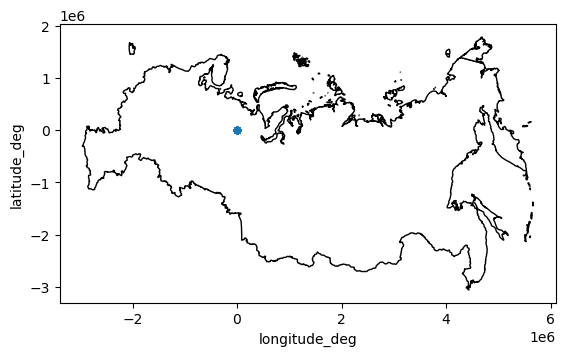

In [39]:
# let's plot

base = russia.plot(color='white', edgecolor='black') #unprojected

infoairports.plot.scatter(x = 'longitude_deg', y = 'latitude_deg',ax=base)

In [40]:
airports=gpd.GeoDataFrame(data=infoairports.copy(),
                 geometry=gpd.points_from_xy(infoairports.longitude_deg,
                                             infoairports.latitude_deg), 
                 crs=4326)

In [41]:
airports=airports.to_crs(5940)

<Axes: >

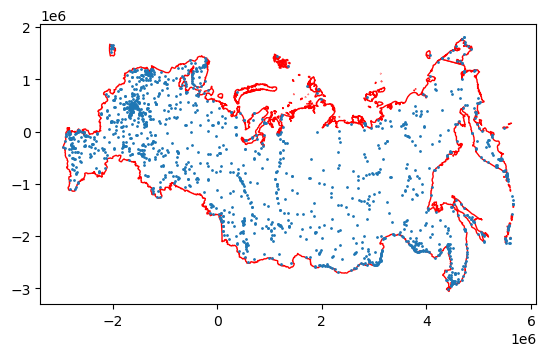

In [42]:
base = russia.plot(color='white', edgecolor='red')
airports.plot(ax=base,markersize=1)

In [43]:
type(airports), type(infoairports)

(geopandas.geodataframe.GeoDataFrame, pandas.core.frame.DataFrame)

In [44]:
airports['type'].value_counts()

type
small_airport     649
heliport          369
closed            280
medium_airport    239
large_airport      16
seaplane_base       4
Name: count, dtype: int64

In [45]:
airports.rename(columns={'type':'kind'},inplace=True)

In [46]:
from folium import LayerControl


m = airports[airports.kind=='small_airport'].explore(color="red",name="small",show=False)
m = airports[airports.kind=='medium_airport'].explore(m=m, color="blue",name="medium",show=False)
m = airports[airports.kind=='large_airport'].explore(m=m, color="black",name="large",show=True)
m = airports[airports.kind=='seaplane_base'].explore(m=m, color="green",name="seaplane",show=False)
m = airports[airports.kind=='closed'].explore(m=m, color="white",name="closed",show=False)
m = airports[airports.kind=='heliport'].explore(m=m, color="orange",name="heliport",show=False)

LayerControl(collapsed=False).add_to(m) #optional

m

In [47]:
#Ejercicio 04

In [48]:
centroRussia=russia.centroid
centroRussia

0    POINT (1533901.375 -637646.068)
dtype: geometry

In [49]:
type(centroRussia), type(centroRussia.x)

(geopandas.geoseries.GeoSeries, pandas.core.series.Series)

In [50]:
type(centroRussia.x[0]),type(centroRussia.y[0])

(numpy.float64, numpy.float64)

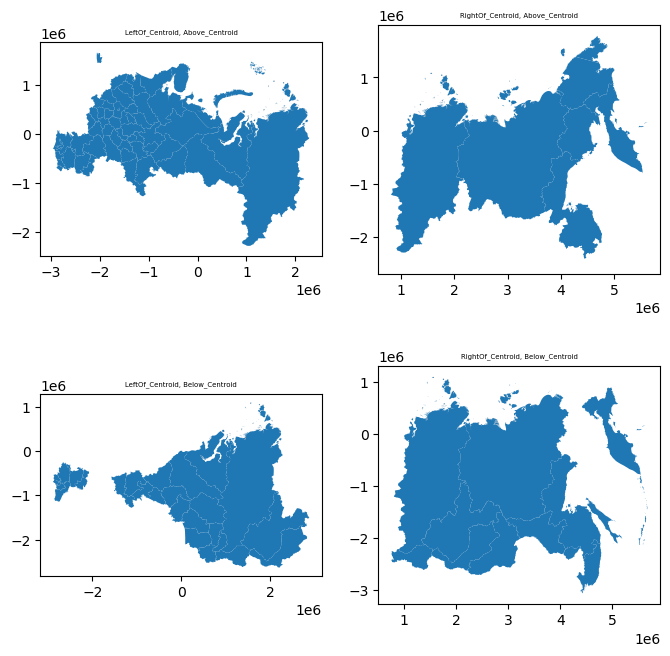

In [51]:
fig, axs = plt.subplots(nrows=2,ncols=2,sharex=False, sharey=False,figsize=(8,8))

centroidX=centroRussia.x[0]
centroidY=centroRussia.y[0]

axs[0,0].set_title('LeftOf_Centroid, Above_Centroid',fontsize=5)
russia_municipalities.cx[:centroidX,centroidY:].plot(ax=axs[0,0]) 

axs[0,1].set_title('RightOf_Centroid, Above_Centroid',fontsize=5)
russia_municipalities.cx[centroidX:,centroidY:].plot(ax=axs[0,1]) 

axs[1,0].set_title('LeftOf_Centroid, Below_Centroid',fontsize=5)
russia_municipalities.cx[:centroidX,:centroidY].plot(ax=axs[1,0]) 

axs[1,1].set_title('RightOf_Centroid, Below_Centroid',fontsize=5)
russia_municipalities.cx[centroidX:,:centroidY].plot(ax=axs[1,1]) ;

In [52]:
russia_municipalities.cx[:centroidX,centroidY:]

,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code,geometry
2,Russian Federation,RU,South federal district,RU006,Adygey,RU006001,20RUS006001,"POLYGON Z ((-2760919.339 -184535.392 0.000, -2..."
3,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,"POLYGON Z ((-939696.359 -454787.409 0.000, -94..."
4,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,"POLYGON Z ((-2086735.582 -512613.443 0.000, -2..."
8,Russian Federation,RU,Northwestern Federal District,RU004,City of St. Petersburg,RU004002,20RUS004002,MULTIPOLYGON Z (((-1299898.992 1104723.548 0.0...
9,Russian Federation,RU,Ural Federal District,RU007,Yamal-Nenets,RU007006,20RUS007006,"MULTIPOLYGON Z (((515936.589 182250.679 0.000,..."
11,Russian Federation,RU,South federal district,RU006,Rostov,RU006005,20RUS006005,MULTIPOLYGON Z (((-2582643.832 32599.747 0.000...
12,Russian Federation,RU,Northwestern Federal District,RU004,Nenets,RU004008,20RUS004008,"MULTIPOLYGON Z (((112549.001 459491.217 0.000,..."
13,Russian Federation,RU,Northwestern Federal District,RU004,Murmansk,RU004007,20RUS004007,MULTIPOLYGON Z (((-507898.640 1193570.440 0.00...
15,Russian Federation,RU,Northwestern Federal District,RU004,Leningrad,RU004006,20RUS004006,MULTIPOLYGON Z (((-1438094.868 1222663.010 0.0...
16,Russian Federation,RU,Siberian Federal District,RU005,Krasnoyarsk,RU005007,20RUS005007,MULTIPOLYGON Z (((2158789.760 275339.243 0.000...


In [53]:
russia_municipalities.cx[:centroidX,centroidY:].dissolve()


,geometry,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code
0,MULTIPOLYGON Z (((-763906.540 -699114.735 0.00...,Russian Federation,RU,South federal district,RU006,Adygey,RU006001,20RUS006001


In [54]:
type(russia_municipalities.cx[:centroidX,centroidY:].dissolve())

geopandas.geodataframe.GeoDataFrame

<Axes: >

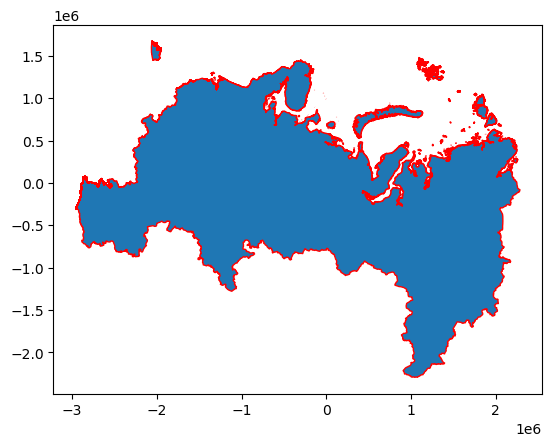

In [55]:
russia_municipalities.cx[:centroidX,centroidY:].dissolve().plot(edgecolor='red')

<Axes: >

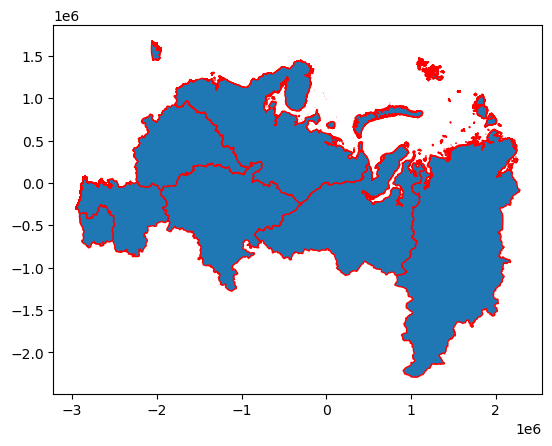

In [56]:
russia_municipalities.cx[:centroidX,centroidY:].dissolve(by='ADM1_EN').plot(edgecolor='red')

In [57]:
russia_municipalities.cx[:centroidX,centroidY:].unary_union

In [58]:
type(russia_municipalities.cx[:centroidX,centroidY:].unary_union)

shapely.geometry.multipolygon.MultiPolygon

In [59]:
gpd.GeoDataFrame(index=[0],
                 crs=russia_municipalities.crs,
                 geometry=[russia_municipalities.cx[:centroidX,centroidY:].unary_union])

,geometry
0,MULTIPOLYGON Z (((-763906.540 -699114.735 0.00...


In [60]:
Russia_topLeft=russia_municipalities.cx[:centroidX,centroidY:].dissolve()
Russia_topLeft

,geometry,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code
0,MULTIPOLYGON Z (((-763906.540 -699114.735 0.00...,Russian Federation,RU,South federal district,RU006,Adygey,RU006001,20RUS006001


In [61]:
Russia_topLeft['zone']='NW'
Russia_topLeft=Russia_topLeft.loc[:,['ADM0_EN','zone','geometry']]   # keep some
Russia_topLeft

,ADM0_EN,zone,geometry
0,Russian Federation,NW,MULTIPOLYGON Z (((-763906.540 -699114.735 0.00...


In [62]:
Russia_topRight=russia_municipalities.cx[centroidX:,centroidY:].dissolve()
Russia_bottomLeft=russia_municipalities.cx[:centroidX,:centroidY].dissolve()
Russia_bottomRight=russia_municipalities.cx[centroidX:,:centroidY].dissolve()

Russia_topRight['zone']='NE'
Russia_topRight=Russia_topRight.loc[:,['ADM0_EN','zone','geometry']] 

Russia_bottomLeft['zone']='NE'
Russia_bottomLeft=Russia_bottomLeft.loc[:,['ADM0_EN','zone','geometry']] 

Russia_bottomRight['zone']='NE'
Russia_bottomRight=Russia_bottomRight.loc[:,['ADM0_EN','zone','geometry']] 

In [63]:
russia_municipalities

,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code,geometry
0,Russian Federation,RU,Ural Federal District,RU007,Chelyabinsk,RU007001,20RUS007001,"POLYGON Z ((-652444.707 -775392.077 0.000, -65..."
1,Russian Federation,RU,North Caucasus federal district,RU003,Ingush,RU003003,20RUS003003,"POLYGON Z ((-2723919.744 -715584.477 0.000, -2..."
2,Russian Federation,RU,South federal district,RU006,Adygey,RU006001,20RUS006001,"POLYGON Z ((-2760919.339 -184535.392 0.000, -2..."
3,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,"POLYGON Z ((-939696.359 -454787.409 0.000, -94..."
4,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,"POLYGON Z ((-2086735.582 -512613.443 0.000, -2..."
...,...,...,...,...,...,...,...,...
78,Russian Federation,RU,Central Federal District,RU001,Smolensk,RU001012,20RUS001012,"POLYGON Z ((-1668568.681 735564.185 0.000, -16..."
79,Russian Federation,RU,Northwestern Federal District,RU004,Pskov,RU004010,20RUS004010,"POLYGON Z ((-1436872.425 1194812.751 0.000, -1..."
80,Russian Federation,RU,South federal district,RU006,Krasnodar,RU006004,20RUS006004,"MULTIPOLYGON Z (((-2601547.800 -934.074 0.000,..."
81,Russian Federation,RU,Northwestern Federal District,RU004,Karelia,RU004004,20RUS004004,MULTIPOLYGON Z (((-520967.507 1260103.869 0.00...


In [64]:
rowsCX=(russia_municipalities.cx[:centroRussia.x[0],centroRussia.y[0]:].shape[0],\
        russia_municipalities.cx[centroRussia.x[0]:,centroRussia.y[0]:].shape[0],\
        russia_municipalities.cx[:centroRussia.x[0],:centroRussia.y[0]].shape[0],\
        russia_municipalities.cx[centroRussia.x[0]:,:centroRussia.y[0]].shape[0])

sum(rowsCX)

102

In [65]:
# coincidences:
len(set(russia_municipalities.cx[:centroRussia.x[0],centroRussia.y[0]:].ADM2_PCODE). \
intersection(set(russia_municipalities.cx[centroRussia.x[0]:,centroRussia.y[0]:].ADM2_PCODE)). \
intersection(set(russia_municipalities.cx[:centroRussia.x[0],:centroRussia.y[0]].ADM2_PCODE)). \
intersection(set(russia_municipalities.cx[centroRussia.x[0]:,:centroRussia.y[0]].ADM2_PCODE)))

1

In [66]:
russia_municipalities.shape[0]

83

<Axes: >

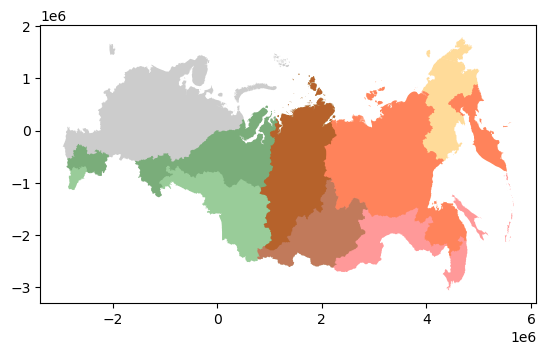

In [67]:
base=Russia_topLeft.plot(facecolor='grey', alpha=0.4)
Russia_topRight.plot(ax=base,facecolor='orange', alpha=0.4)
Russia_bottomLeft.plot(ax=base,facecolor='green', alpha=0.4)
Russia_bottomRight.plot(ax=base,facecolor='red', alpha=0.4)

In [68]:
#Ejercicio 05

In [69]:
Russia_AirTopLeft=airports[airports.kind=='medium_airport'].cx[:centroidX,centroidY:]
Russia_AirTopRight=airports[airports.kind=='medium_airport'].cx[centroidX:,centroidY:]
Russia_AirBottomLeft=airports[airports.kind=='medium_airport'].cx[:centroidX,:centroidY]
Russia_AirBottomRight=airports[airports.kind=='medium_airport'].cx[centroidX:,:centroidY]

<Axes: >

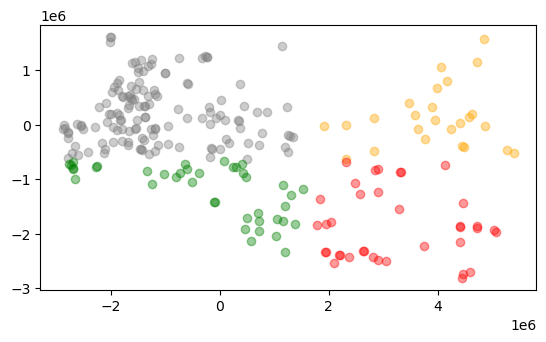

In [70]:
base=Russia_AirTopLeft.plot(facecolor='grey', alpha=0.4)
Russia_AirTopRight.plot(ax=base,facecolor='orange', alpha=0.4)
Russia_AirBottomLeft.plot(ax=base,facecolor='green', alpha=0.4)
Russia_AirBottomRight.plot(ax=base,facecolor='red', alpha=0.4)

In [71]:
Russia_AirBottomLeft

,name,kind,latitude_deg,longitude_deg,elevation_ft,region_name,municipality,geometry
15,Bogashevo Airport,medium_airport,56.380299,85.208298,597.0,Tomsk Oblast,Tomsk,POINT (700048.073 -1612396.768)
25,Chelyabinsk Balandino Airport,medium_airport,55.305801,61.503300,769.0,Chelyabinsk Oblast,Chelyabinsk,POINT (-732124.063 -879390.157)
27,Omsk Central Airport,medium_airport,54.966999,73.310501,311.0,Omsk Oblast,Omsk,POINT (-106772.830 -1412554.727)
29,Roshchino International Airport,medium_airport,57.189602,65.324303,378.0,Tyumen Oblast,Tyumen,POINT (-388816.104 -879827.468)
35,Astrakhan Narimanovo Boris M. Kustodiev Intern...,medium_airport,46.282843,48.010511,-65.0,Astrakhan Oblast,Astrakhan,POINT (-2271827.302 -775271.392)
37,Nizhnevartovsk Airport,medium_airport,60.949299,76.483597,177.0,Khanty-Mansi Autonomous Okrug,Nizhnevartovsk,POINT (427673.365 -893889.412)
45,Grozny Airport,medium_airport,43.388106,45.699772,548.0,Chechen Republic,Grozny,POINT (-2702683.749 -792223.965)
46,Makhachkala Uytash International Airport,medium_airport,42.816799,47.652302,12.0,Republic of Dagestan,Makhachkala,POINT (-2667908.533 -991259.372)
48,Orsk Airport,medium_airport,51.072498,58.595600,909.0,Orenburg Oblast,Orsk,POINT (-1251381.637 -1095772.805)
51,Surgut Airport,medium_airport,61.343700,73.401802,200.0,Khanty-Mansi Autonomous Okrug,Surgut,POINT (298770.066 -765504.683)


<Axes: >

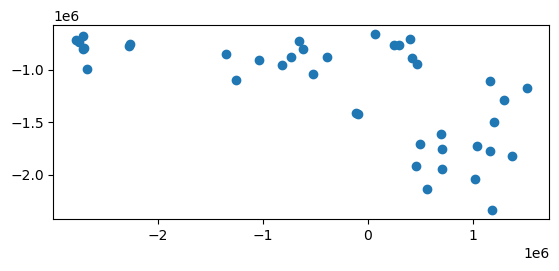

In [72]:
Russia_AirBottomLeft.convex_hull.plot()

<Axes: >

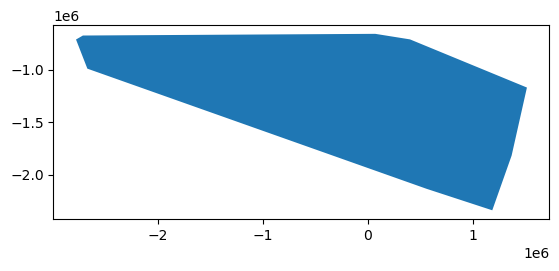

In [73]:
Russia_AirBottomLeft.dissolve().convex_hull.plot()

In [74]:
Russia_AirBottomLeft.dissolve().convex_hull

0    POLYGON ((1187834.181 -2340019.774, 562781.760...
dtype: geometry

<Axes: >

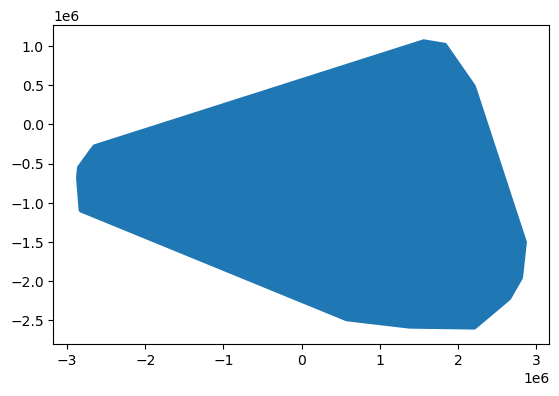

In [75]:
Russia_bottomLeft.convex_hull.plot()

<Axes: >

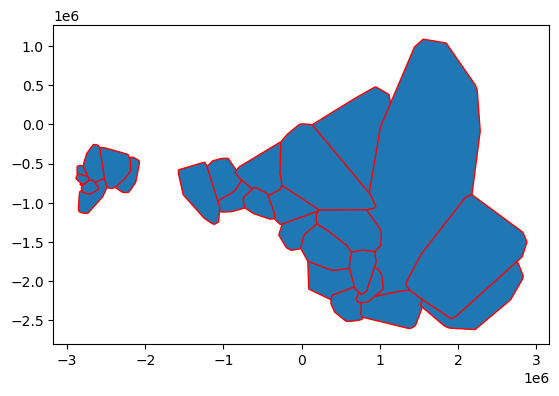

In [76]:
russia_municipalities.cx[:centroidX,:centroidY].convex_hull.plot(edgecolor='red')

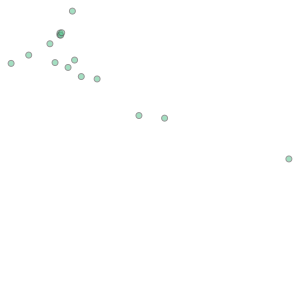

In [77]:
large_airport=airports[airports.kind=='large_airport']
large_airport.unary_union

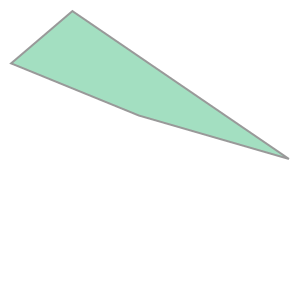

In [78]:
large_airport.unary_union.convex_hull

In [79]:
LargeAirport_hull= gpd.GeoDataFrame(index=[0],
                                    crs=large_airport.crs,
                                    geometry=[large_airport.unary_union.convex_hull])
LargeAirport_hull['name']='large airports hull' # optional

# then

LargeAirport_hull

,geometry,name
0,"POLYGON ((4495053.948 -2865674.500, 475373.773...",large airports hull


<Axes: >

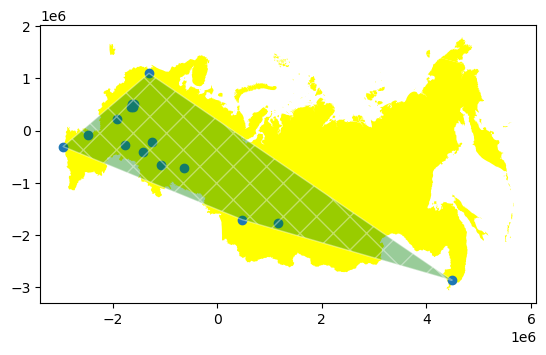

In [80]:
base=russia.plot(facecolor='yellow')
large_airport.plot(ax=base)
LargeAirport_hull.plot(ax=base,facecolor='green',
                       edgecolor='white',alpha=0.4,
                       hatch='X')

In [81]:
#Ejercicio 06

In [82]:
# the north
MunisN_russia=russia_municipalities.cx[:,centroidY:]
# the south
MunisS_russia=russia_municipalities.cx[:,:centroidY]
# the west
MunisW_russia=russia_municipalities.cx[:centroidX,:]
# the east
MunisE_russia=russia_municipalities.cx[centroidX:,:]

In [83]:
munisMidNS_russia=MunisN_russia.overlay(MunisS_russia, how="intersection",keep_geom_type=True)
munisMidNS_russia

,ADM0_EN_1,ADM0_PCODE_1,ADM1_EN_1,ADM1_PCODE_1,ADM2_EN_1,ADM2_PCODE_1,UNHCR_code_1,ADM0_EN_2,ADM0_PCODE_2,ADM1_EN_2,ADM1_PCODE_2,ADM2_EN_2,ADM2_PCODE_2,UNHCR_code_2,geometry
0,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,"POLYGON Z ((-940350.867 -463978.422 0.000, -93..."
1,Russian Federation,RU,Ural Federal District,RU007,Sverdlovsk,RU007004,20RUS007004,Russian Federation,RU,Ural Federal District,RU007,Sverdlovsk,RU007004,20RUS007004,"POLYGON Z ((-262318.665 -267797.903 0.000, -25..."
2,Russian Federation,RU,Volga Federal District,RU008,Orenburg,RU008007,20RUS008007,Russian Federation,RU,Volga Federal District,RU008,Orenburg,RU008007,20RUS008007,"POLYGON Z ((-1236476.774 -493151.626 0.000, -1..."
3,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,"POLYGON Z ((-2102271.134 -515776.137 0.000, -2..."
4,Russian Federation,RU,South federal district,RU006,Kalmyk,RU006003,20RUS006003,Russian Federation,RU,South federal district,RU006,Kalmyk,RU006003,20RUS006003,"POLYGON Z ((-2231914.818 -408118.298 0.000, -2..."
5,Russian Federation,RU,Ural Federal District,RU007,Yamal-Nenets,RU007006,20RUS007006,Russian Federation,RU,Ural Federal District,RU007,Yamal-Nenets,RU007006,20RUS007006,MULTIPOLYGON Z (((431391.063 -112618.987 0.000...
6,Russian Federation,RU,Siberian Federal District,RU005,Krasnoyarsk,RU005007,20RUS005007,Russian Federation,RU,Siberian Federal District,RU005,Krasnoyarsk,RU005007,20RUS005007,MULTIPOLYGON Z (((2151249.830 525893.739 0.000...
7,Russian Federation,RU,Ural Federal District,RU007,Khanty-Mansiy,RU007002,20RUS007002,Russian Federation,RU,Ural Federal District,RU007,Khanty-Mansiy,RU007002,20RUS007002,"POLYGON Z ((95732.285 -96214.718 0.000, 95646...."
8,Russian Federation,RU,Far Eastern Federal District,RU002,Sakha,RU002007,20RUS002007,Russian Federation,RU,Far Eastern Federal District,RU002,Sakha,RU002007,20RUS002007,"MULTIPOLYGON Z (((2274532.065 99297.445 0.000,..."
9,Russian Federation,RU,Far Eastern Federal District,RU002,Khabarovsk,RU002004,20RUS002004,Russian Federation,RU,Far Eastern Federal District,RU002,Khabarovsk,RU002004,20RUS002004,MULTIPOLYGON Z (((3833470.863 -521315.998 0.00...


In [84]:
MunisN_russia.sjoin(MunisS_russia, how="inner", predicate='contains')

,ADM0_EN_left,ADM0_PCODE_left,ADM1_EN_left,ADM1_PCODE_left,ADM2_EN_left,ADM2_PCODE_left,UNHCR_code_left,geometry,index_right,ADM0_EN_right,ADM0_PCODE_right,ADM1_EN_right,ADM1_PCODE_right,ADM2_EN_right,ADM2_PCODE_right,UNHCR_code_right
3,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,"POLYGON Z ((-939696.359 -454787.409 0.000, -94...",3,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001
4,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,"POLYGON Z ((-2086735.582 -512613.443 0.000, -2...",4,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002
9,Russian Federation,RU,Ural Federal District,RU007,Yamal-Nenets,RU007006,20RUS007006,"MULTIPOLYGON Z (((515936.589 182250.679 0.000,...",9,Russian Federation,RU,Ural Federal District,RU007,Yamal-Nenets,RU007006,20RUS007006
10,Russian Federation,RU,Far Eastern Federal District,RU002,Sakha,RU002007,20RUS002007,"MULTIPOLYGON Z (((2274598.412 99307.029 0.000,...",10,Russian Federation,RU,Far Eastern Federal District,RU002,Sakha,RU002007,20RUS002007
16,Russian Federation,RU,Siberian Federal District,RU005,Krasnoyarsk,RU005007,20RUS005007,MULTIPOLYGON Z (((2158789.760 275339.243 0.000...,16,Russian Federation,RU,Siberian Federal District,RU005,Krasnoyarsk,RU005007,20RUS005007
17,Russian Federation,RU,Far Eastern Federal District,RU002,Kamchatka,RU002003,20RUS002003,MULTIPOLYGON Z (((5072992.963 600366.004 0.000...,17,Russian Federation,RU,Far Eastern Federal District,RU002,Kamchatka,RU002003,20RUS002003
19,Russian Federation,RU,North Caucasus federal district,RU003,Kabardin-Balkar,RU003004,20RUS003004,"POLYGON Z ((-2705512.113 -662619.285 0.000, -2...",19,Russian Federation,RU,North Caucasus federal district,RU003,Kabardin-Balkar,RU003004,20RUS003004
25,Russian Federation,RU,North Caucasus federal district,RU003,North Ossetia,RU003006,20RUS003006,"POLYGON Z ((-2703362.553 -703319.236 0.000, -2...",25,Russian Federation,RU,North Caucasus federal district,RU003,North Ossetia,RU003006,20RUS003006
41,Russian Federation,RU,Ural Federal District,RU007,Sverdlovsk,RU007004,20RUS007004,"POLYGON Z ((-261888.067 -260885.563 0.000, -26...",41,Russian Federation,RU,Ural Federal District,RU007,Sverdlovsk,RU007004,20RUS007004
42,Russian Federation,RU,North Caucasus federal district,RU003,Stavropol',RU003007,20RUS003007,"POLYGON Z ((-2511397.091 -448846.511 0.000, -2...",42,Russian Federation,RU,North Caucasus federal district,RU003,Stavropol',RU003007,20RUS003007


<Axes: >

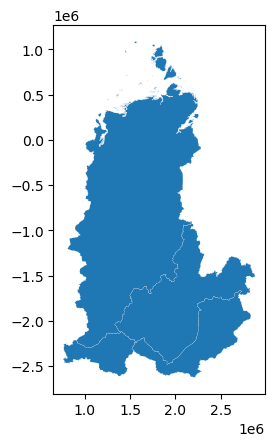

In [85]:
#superposición
munisMidWE_russia=MunisW_russia.overlay(MunisE_russia, how="intersection",keep_geom_type=True)
munisMidWE_russia.plot(edgecolor='white',linewidth=0.1)

In [86]:
munisMidNS_russia.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 14 entries, 0 to 13
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   ADM0_EN_1     14 non-null     object  
 1   ADM0_PCODE_1  14 non-null     object  
 2   ADM1_EN_1     14 non-null     object  
 3   ADM1_PCODE_1  14 non-null     object  
 4   ADM2_EN_1     14 non-null     object  
 5   ADM2_PCODE_1  14 non-null     object  
 6   UNHCR_code_1  14 non-null     object  
 7   ADM0_EN_2     14 non-null     object  
 8   ADM0_PCODE_2  14 non-null     object  
 9   ADM1_EN_2     14 non-null     object  
 10  ADM1_PCODE_2  14 non-null     object  
 11  ADM2_EN_2     14 non-null     object  
 12  ADM2_PCODE_2  14 non-null     object  
 13  UNHCR_code_2  14 non-null     object  
 14  geometry      14 non-null     geometry
dtypes: geometry(1), object(14)
memory usage: 1.8+ KB


In [87]:
munisMidWE_russia.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   ADM0_EN_1     4 non-null      object  
 1   ADM0_PCODE_1  4 non-null      object  
 2   ADM1_EN_1     4 non-null      object  
 3   ADM1_PCODE_1  4 non-null      object  
 4   ADM2_EN_1     4 non-null      object  
 5   ADM2_PCODE_1  4 non-null      object  
 6   UNHCR_code_1  4 non-null      object  
 7   ADM0_EN_2     4 non-null      object  
 8   ADM0_PCODE_2  4 non-null      object  
 9   ADM1_EN_2     4 non-null      object  
 10  ADM1_PCODE_2  4 non-null      object  
 11  ADM2_EN_2     4 non-null      object  
 12  ADM2_PCODE_2  4 non-null      object  
 13  UNHCR_code_2  4 non-null      object  
 14  geometry      4 non-null      geometry
dtypes: geometry(1), object(14)
memory usage: 612.0+ bytes


In [88]:
keep=['ADM0_EN_1','ADM1_PCODE_1','ADM2_PCODE_1','geometry']
munisMidNS_russia=munisMidNS_russia.loc[:,keep]
munisMidWE_russia=munisMidWE_russia.loc[:,keep]

In [89]:
munisMidNS_russia.overlay(munisMidWE_russia,how="union",keep_geom_type=True)

,ADM0_EN_1_1,ADM1_PCODE_1_1,ADM2_PCODE_1_1,ADM0_EN_1_2,ADM1_PCODE_1_2,ADM2_PCODE_1_2,geometry
0,Russian Federation,RU005,RU005007,Russian Federation,RU005,RU005007,MULTIPOLYGON Z (((2151195.801 525888.197 0.000...
1,Russian Federation,RU008,RU008001,NaN,NaN,NaN,"POLYGON Z ((-940350.867 -463978.422 0.000, -93..."
2,Russian Federation,RU007,RU007004,NaN,NaN,NaN,"POLYGON Z ((-262318.665 -267797.903 0.000, -25..."
3,Russian Federation,RU008,RU008007,NaN,NaN,NaN,"POLYGON Z ((-1236476.774 -493151.626 0.000, -1..."
4,Russian Federation,RU006,RU006002,NaN,NaN,NaN,"POLYGON Z ((-2102271.134 -515776.137 0.000, -2..."
5,Russian Federation,RU006,RU006003,NaN,NaN,NaN,"POLYGON Z ((-2231914.818 -408118.298 0.000, -2..."
6,Russian Federation,RU007,RU007006,NaN,NaN,NaN,MULTIPOLYGON Z (((431313.633 -112561.493 0.000...
7,Russian Federation,RU007,RU007002,NaN,NaN,NaN,"POLYGON Z ((95646.078 -99686.827 0.000, 94029...."
8,Russian Federation,RU002,RU002007,NaN,NaN,NaN,"MULTIPOLYGON Z (((2274392.736 99277.325 0.000,..."
9,Russian Federation,RU002,RU002004,NaN,NaN,NaN,MULTIPOLYGON Z (((3833470.863 -521315.998 0.00...


In [90]:
pd.concat([munisMidNS_russia,munisMidWE_russia],ignore_index=True)

,ADM0_EN_1,ADM1_PCODE_1,ADM2_PCODE_1,geometry
0,Russian Federation,RU008,RU008001,"POLYGON Z ((-940350.867 -463978.422 0.000, -93..."
1,Russian Federation,RU007,RU007004,"POLYGON Z ((-262318.665 -267797.903 0.000, -25..."
2,Russian Federation,RU008,RU008007,"POLYGON Z ((-1236476.774 -493151.626 0.000, -1..."
3,Russian Federation,RU006,RU006002,"POLYGON Z ((-2102271.134 -515776.137 0.000, -2..."
4,Russian Federation,RU006,RU006003,"POLYGON Z ((-2231914.818 -408118.298 0.000, -2..."
5,Russian Federation,RU007,RU007006,MULTIPOLYGON Z (((431391.063 -112618.987 0.000...
6,Russian Federation,RU005,RU005007,MULTIPOLYGON Z (((2151249.830 525893.739 0.000...
7,Russian Federation,RU007,RU007002,"POLYGON Z ((95732.285 -96214.718 0.000, 95646...."
8,Russian Federation,RU002,RU002007,"MULTIPOLYGON Z (((2274532.065 99297.445 0.000,..."
9,Russian Federation,RU002,RU002004,MULTIPOLYGON Z (((3833470.863 -521315.998 0.00...


<Axes: >

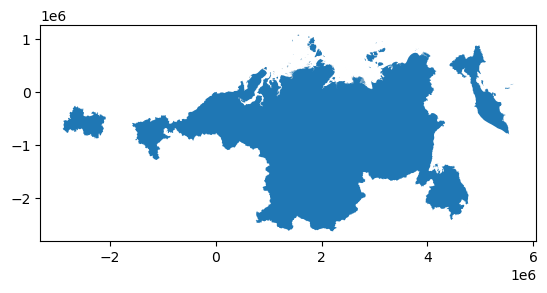

In [91]:
munisMidNS_russia.dissolve().overlay(munisMidWE_russia.dissolve(), how="union",keep_geom_type=True).dissolve().plot()

In [92]:
muniMidRussia=munisMidNS_russia.dissolve().overlay(munisMidWE_russia.dissolve(), how="union",keep_geom_type=True).dissolve()
muniMidRussia

,geometry,ADM0_EN_1_1,ADM1_PCODE_1_1,ADM2_PCODE_1_1,ADM0_EN_1_2,ADM1_PCODE_1_2,ADM2_PCODE_1_2
0,MULTIPOLYGON Z (((-2733129.346 -700846.175 0.0...,Russian Federation,RU008,RU008001,Russian Federation,RU005,RU005011


In [93]:
muniMidRussia['zone']='middles'
muniMidRussia=muniMidRussia.loc[:,['ADM0_EN_1_1','zone','geometry']]   
muniMidRussia

,ADM0_EN_1_1,zone,geometry
0,Russian Federation,middles,MULTIPOLYGON Z (((-2733129.346 -700846.175 0.0...


<Axes: >

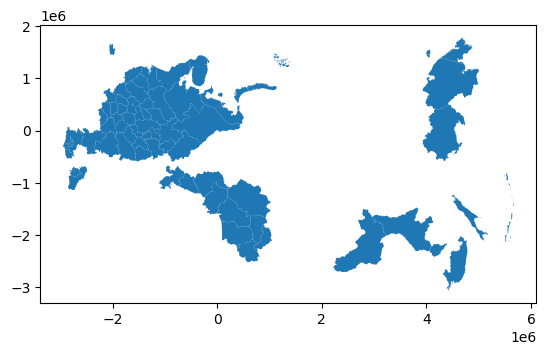

In [94]:
#Municipios
russia_municipalities.overlay(muniMidRussia, how='difference').plot()

<Axes: >

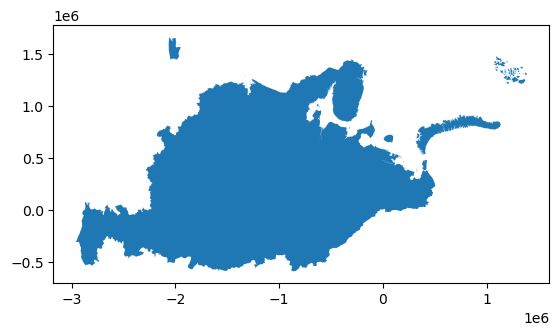

In [95]:
#zonas
Russia_topLeft.overlay(muniMidRussia, how='difference').plot()

<Axes: >

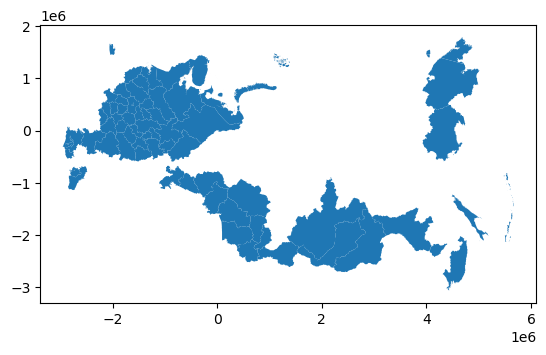

In [97]:
MunisN_russia.overlay(MunisS_russia, how="symmetric_difference",keep_geom_type=False).plot()

<Axes: >

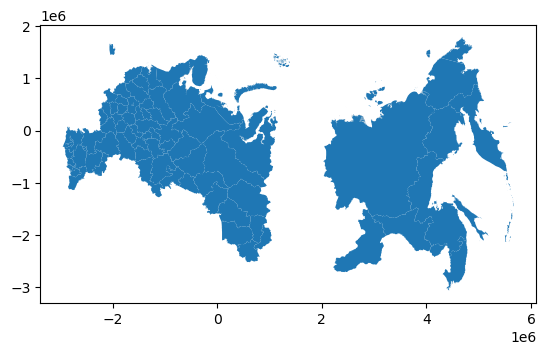

In [98]:
MunisW_russia.overlay(MunisE_russia, how="symmetric_difference",keep_geom_type=False).plot()

In [99]:
Russia_AirTopLeft_hull=Russia_AirTopLeft.dissolve().convex_hull
Russia_AirTopRight_hull=Russia_AirTopRight.dissolve().convex_hull
Russia_AirBottomLeft_hull=Russia_AirBottomLeft.dissolve().convex_hull
Russia_AirBottomRight_hull=Russia_AirBottomRight.dissolve().convex_hull

<Axes: >

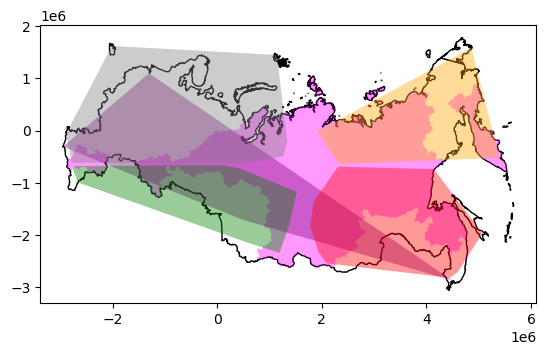

In [100]:
base = russia.plot(color='white', edgecolor='black') #unprojected
muniMidRussia.plot(ax=base,facecolor='magenta',alpha=0.4) #unprojected
LargeAirport_hull.plot(ax=base,facecolor='purple',alpha=0.4)
Russia_AirTopLeft_hull.plot(ax=base,facecolor='grey', alpha=0.4)
Russia_AirTopRight_hull.plot(ax=base,facecolor='orange', alpha=0.4)
Russia_AirBottomLeft_hull.plot(ax=base,facecolor='green', alpha=0.4)
Russia_AirBottomRight_hull.plot(ax=base,facecolor='red', alpha=0.4)

In [101]:
intersec_muni_airport= gpd.overlay(muniMidRussia, LargeAirport_hull, how='intersection')
intersec_top= Russia_AirTopLeft_hull.intersection(muniMidRussia)

<Axes: >

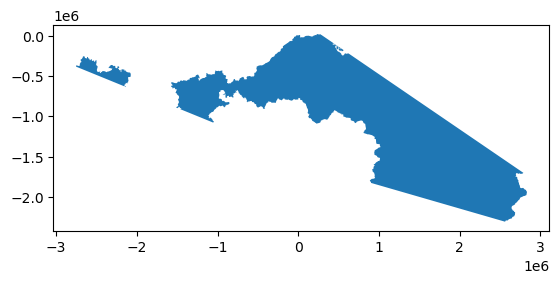

In [102]:
intersec_muni_airport.plot()

<Axes: >

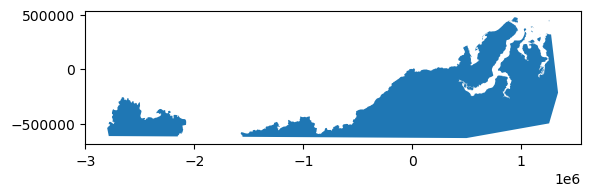

In [103]:
intersec_top.plot()

<Axes: >

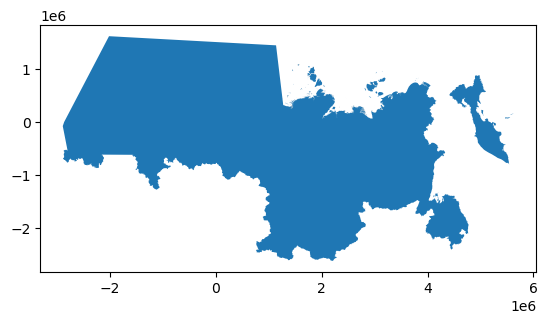

In [104]:
union_top = Russia_AirTopLeft_hull.union(muniMidRussia)
union_top.plot()

<Axes: >

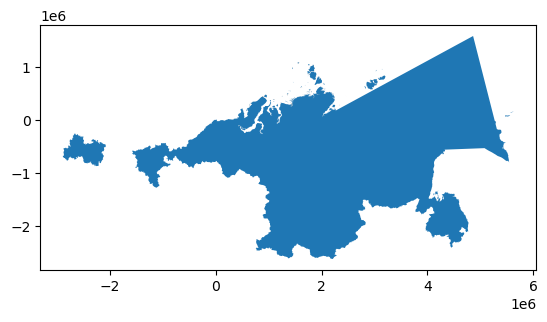

In [106]:
union_top02 = Russia_AirTopRight_hull.union(muniMidRussia)
union_top02.plot()

<Axes: >

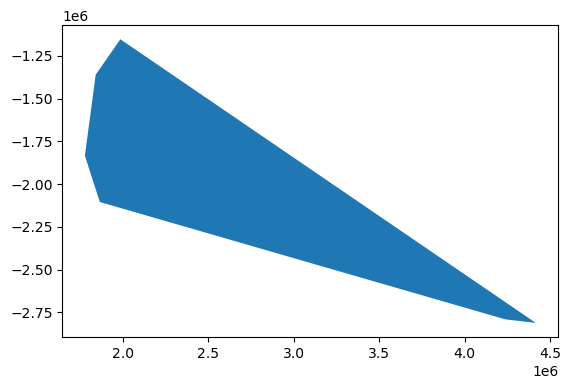

In [107]:
intersection01=LargeAirport_hull.intersection(Russia_AirBottomRight_hull)
intersection01.plot()